In [1]:
import os
import time
import datetime
import time
import numpy as np
import matplotlib.pyplot as plt
import random

from skimage.metrics import structural_similarity
from skimage.metrics import peak_signal_noise_ratio
from sklearn.metrics import mean_squared_error

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torchvision.transforms as T
import torchvision
from torch.optim import Adam
from torch.utils.data import DataLoader, Subset
from torchvision.models import vgg16, vgg19
from torchmetrics.image.ssim import StructuralSimilarityIndexMeasure

from utils.Create_Dataset import PairedImageDataset
from utils.Pairing_Images import PairFinder
from utils.UNetGenerator import UNetGenerator

In [2]:
UNetGenerator(in_channels=3,out_channels=3)

UNetGenerator(
  (down1): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down2): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down3): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down4): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, mom

In [17]:
generator = UNetGenerator(in_channels=3,out_channels=3)
generator.load_state_dict(torch.load("Models/Pix2Pix/GEN/GEN.pth"))
generator.eval()

UNetGenerator(
  (down1): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down2): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down3): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down4): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, mom

In [4]:
IMG_SHAPE = (256,256,3)
TARGET_SHAPE = (256,256,3)
BATCH_SIZE = 1
# base_dir = "/home/nvlabs/.cache/kagglehub/datasets/requiemonk/sentinel12-image-pairs-segregated-by-terrain/versions/1/v_2"
# Dataset Hyper Parameters
subset = "agri"
save_dataframe = "True"
s1_image_path = "Dataset/agri/s1/"
s2_image_path = "Dataset/agri/s2/"

In [5]:
image_dataset = PairedImageDataset(s1_dir=s1_image_path, s2_dir=s2_image_path, subset_name=subset, save_dataframe=save_dataframe)
dataloader = DataLoader(image_dataset, batch_size=BATCH_SIZE, shuffle=True)
print(f"Total Instances = {len(image_dataset)}")

subset_indices = list(range(20))
subset_dataset = Subset(image_dataset, subset_indices)
subset_loader = DataLoader(subset_dataset, batch_size=1, shuffle=False)  # <--- Add this line

print(f"Sample Instances = {len(subset_dataset)}")


Total Instances = 4000
Sample Instances = 20


In [6]:
generator.eval()
for gray,color in subset_loader:
    
    res = generator(gray)
    print(gray.shape,res.shape)
    break

torch.Size([1, 3, 256, 256]) torch.Size([1, 3, 256, 256])


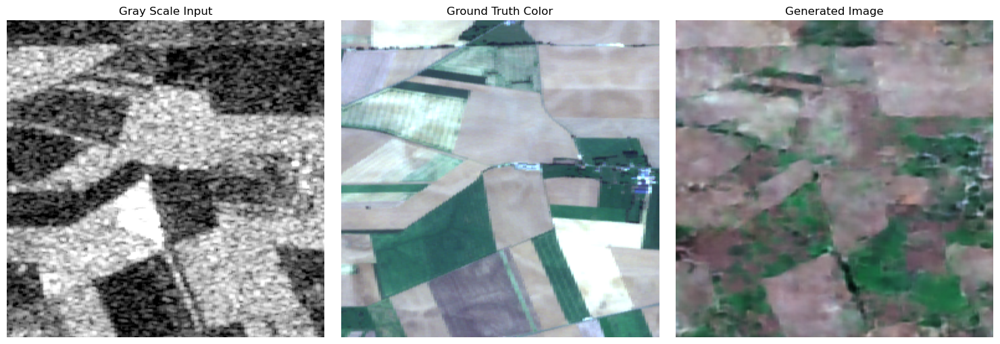

In [7]:
for gray, color in subset_loader:
    
    # Generate image
    with torch.no_grad():
        generated = generator(gray)

    # Detach and convert all to CPU numpy arrays
    gray_np = gray[0].permute(1, 2, 0).cpu().numpy()
    color_np = color[0].permute(1, 2, 0).cpu().numpy()
    gen_np   = generated[0].permute(1, 2, 0).cpu().numpy()

    # If using Tanh activation → [-1, 1], scale to [0, 1]
    gray_np = (gray_np + 1) / 2.0
    color_np = (color_np + 1) / 2.0
    gen_np   = (gen_np + 1) / 2.0

    # Plot them
    plt.figure(figsize=(15, 5))

    titles = ['Gray Scale Input', 'Ground Truth Color', 'Generated Image']
    images = [gray_np, color_np, gen_np]

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.imshow(images[i])
        plt.title(titles[i])
        plt.axis('off')

    plt.tight_layout()
    plt.show()
    break

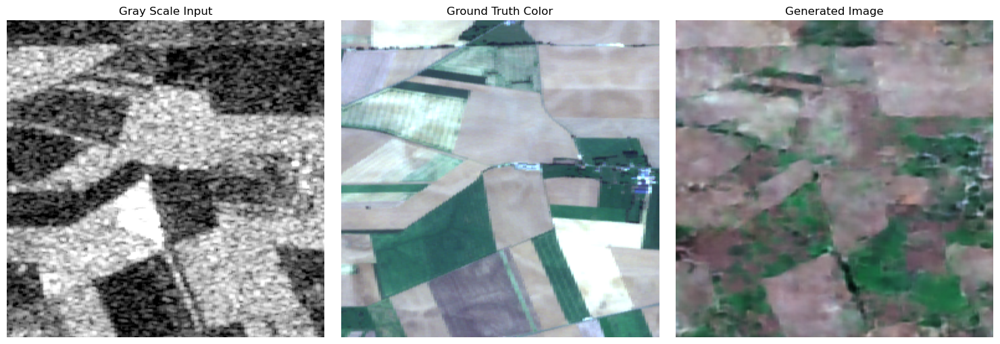

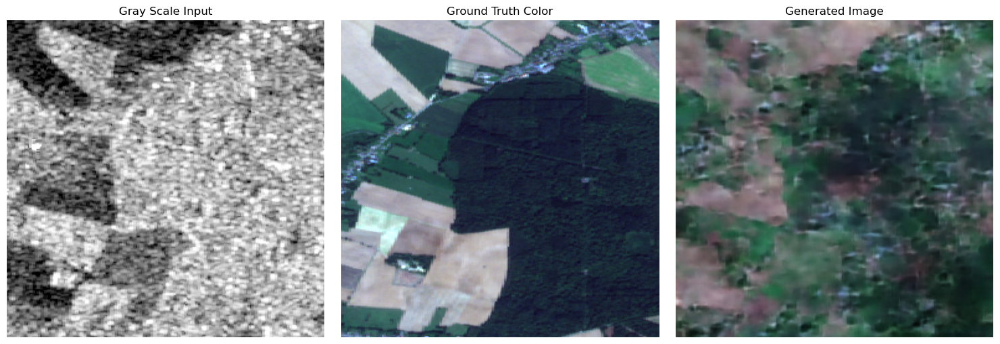

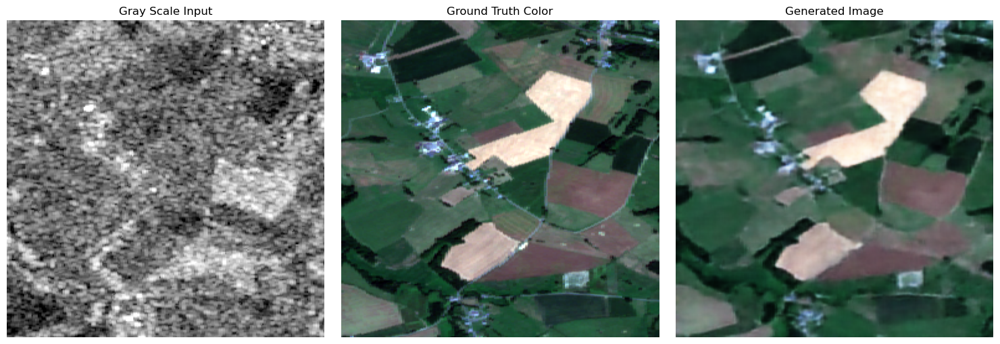

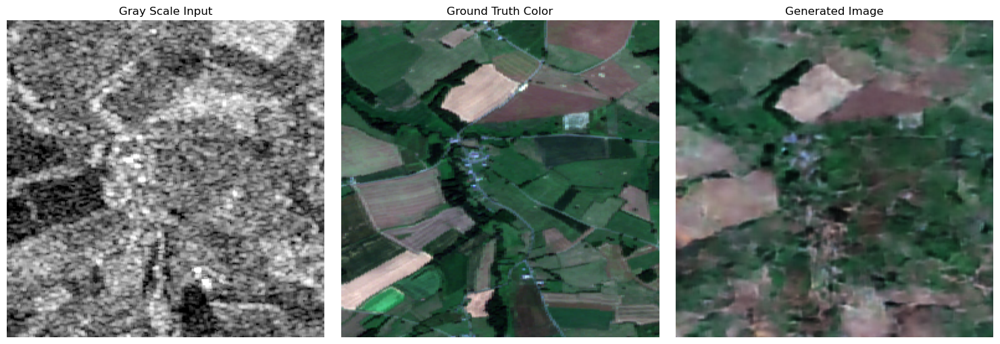

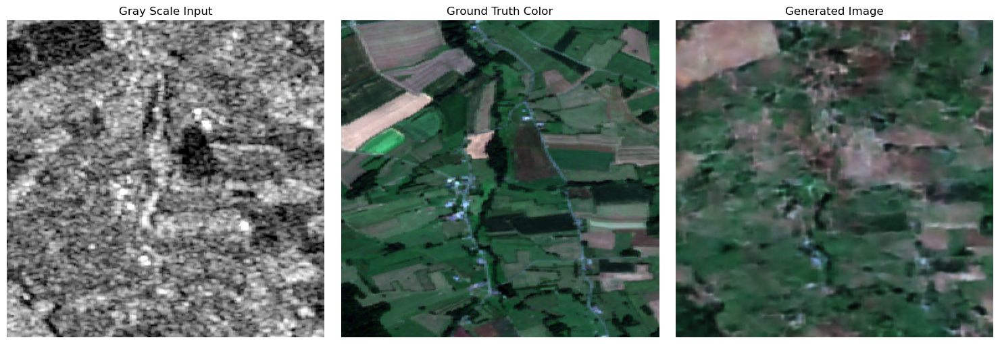

...

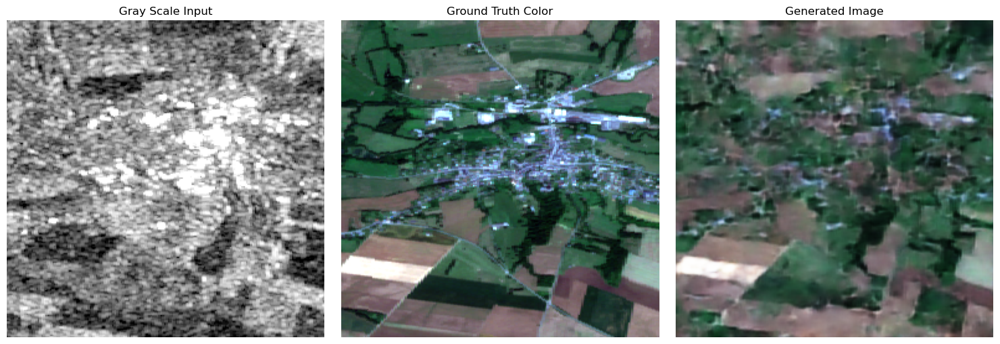

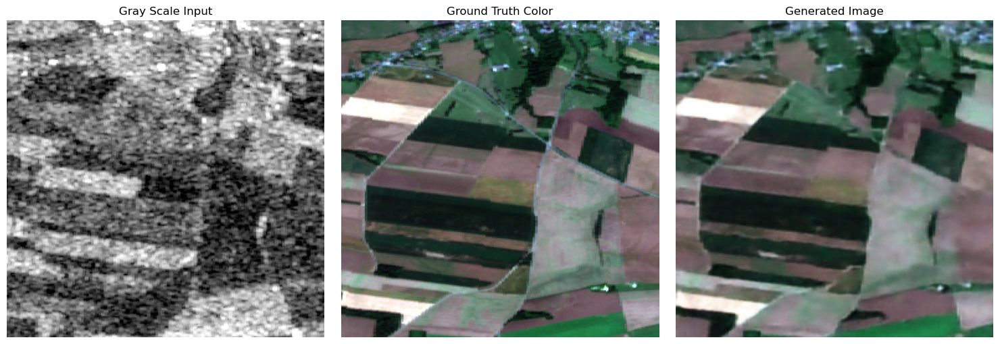

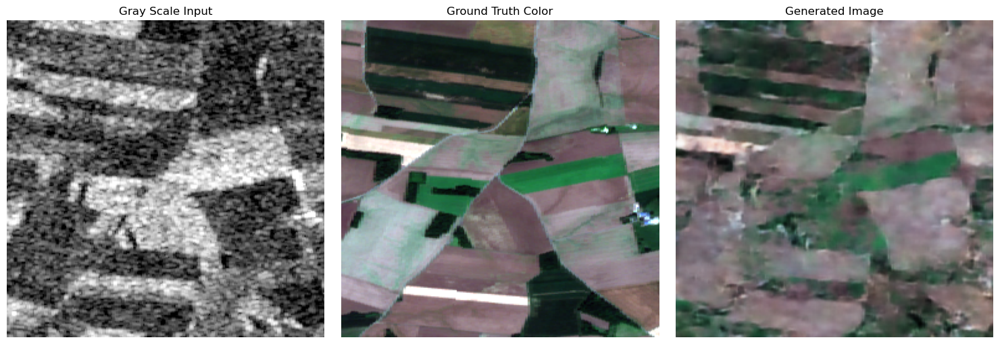

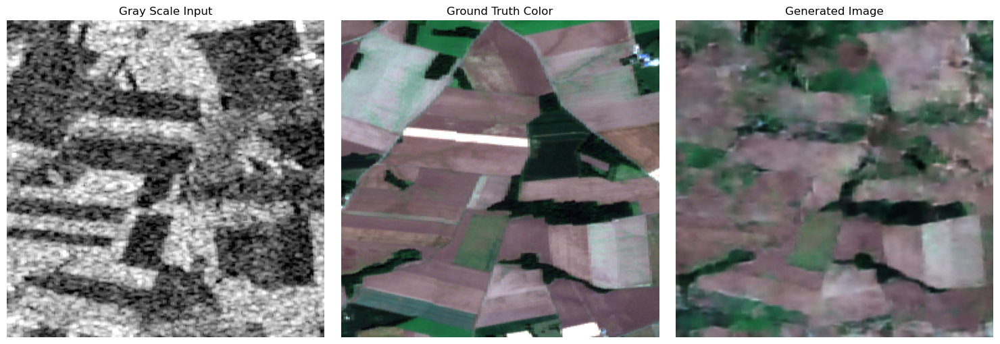

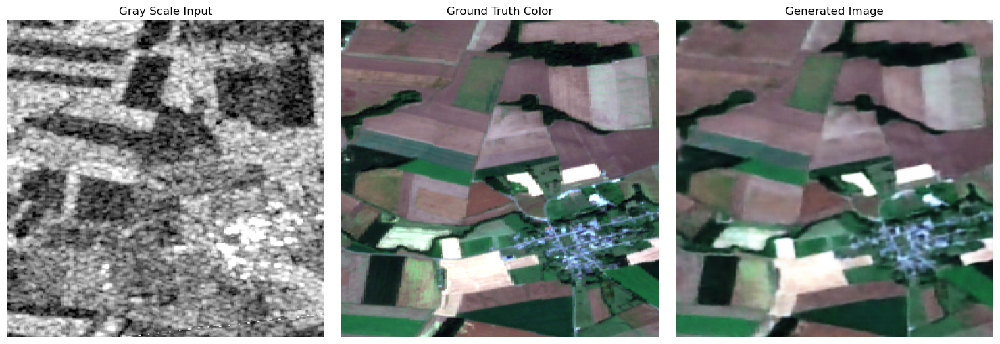

In [23]:
import matplotlib.pyplot as plt
import torch

# Set generator to evaluation mode
generator.eval()

# Counter for number of images plotted
count = 0

# Iterate through the dataset
for gray, color in subset_loader:
    
    # Generate image
    with torch.no_grad():
        generated = generator(gray)

    # Detach and convert all to CPU numpy arrays
    gray_np = gray[0].permute(1, 2, 0).cpu().numpy()
    color_np = color[0].permute(1, 2, 0).cpu().numpy()
    gen_np   = generated[0].permute(1, 2, 0).cpu().numpy()

    # Scale from [-1, 1] to [0, 1] if needed
    gray_np = (gray_np + 1) / 2.0
    color_np = (color_np + 1) / 2.0
    gen_np   = (gen_np + 1) / 2.0

    # Plot them
    plt.figure(figsize=(15, 5))

    titles = ['Gray Scale Input', 'Ground Truth Color', 'Generated Image']
    images = [gray_np, color_np, gen_np]

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.imshow(images[i])
        plt.title(titles[i])
        plt.axis('off')

    # plt.suptitle(f"Image {count + 1}", fontsize=16)
    plt.tight_layout()
    plt.show()

    count += 1
    if count == 20:
        break


In [29]:
generator.load_state_dict(torch.load("Models/Pix2Pix/GEN/generator_epoch_150.pth"))
generator.eval()

UNetGenerator(
  (down1): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down2): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down3): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down4): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, mom

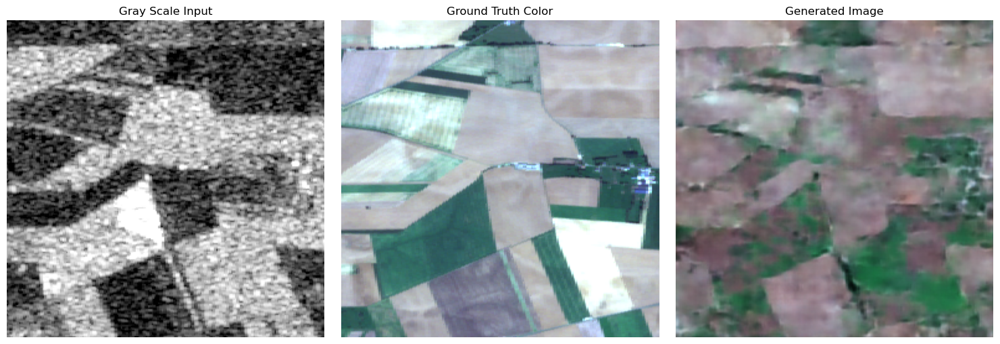

In [31]:
for gray, color in subset_loader:
    
    # Generate image
    with torch.no_grad():
        generated = generator(gray)

    # Detach and convert all to CPU numpy arrays
    gray_np = gray[0].permute(1, 2, 0).cpu().numpy()
    color_np = color[0].permute(1, 2, 0).cpu().numpy()
    gen_np   = generated[0].permute(1, 2, 0).cpu().numpy()

    # If using Tanh activation → [-1, 1], scale to [0, 1]
    gray_np = (gray_np + 1) / 2.0
    color_np = (color_np + 1) / 2.0
    gen_np   = (gen_np + 1) / 2.0

    # Plot them
    plt.figure(figsize=(15, 5))

    titles = ['Gray Scale Input', 'Ground Truth Color', 'Generated Image']
    images = [gray_np, color_np, gen_np]

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.imshow(images[i])
        plt.title(titles[i])
        plt.axis('off')

    plt.tight_layout()
    plt.show()
    break

In [33]:
image_dataset = PairedImageDataset(s1_dir=s1_image_path, s2_dir=s2_image_path, subset_name=subset, save_dataframe=save_dataframe)
dataloader = DataLoader(image_dataset, batch_size=BATCH_SIZE, shuffle=True)
print(f"Total Instances = {len(image_dataset)}")

subset_indices = [2]
subset_dataset = Subset(image_dataset, subset_indices)
subset_loader = DataLoader(subset_dataset, batch_size=1, shuffle=False)  # <--- Add this line

print(f"Sample Instances = {len(subset_dataset)}")


Total Instances = 4000
Sample Instances = 1


In [53]:
generator.load_state_dict(torch.load("Models/Pix2Pix/GEN/GEN.pth"))
generator.eval()

UNetGenerator(
  (down1): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down2): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down3): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (down4): UNetBlockDown(
    (block): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, mom

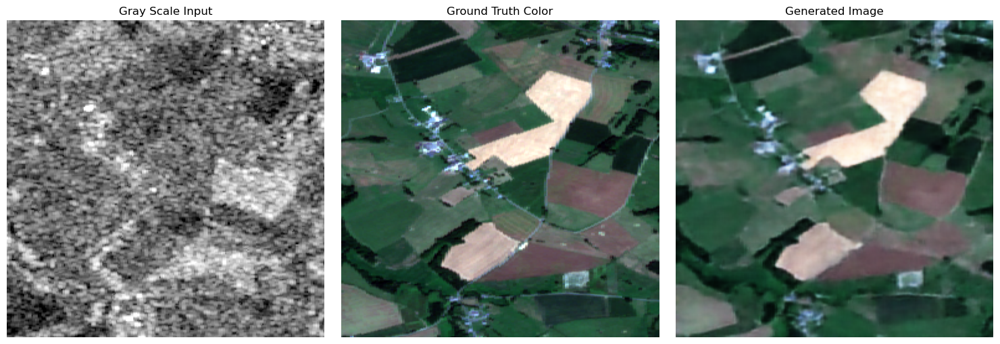

In [55]:
for gray, color in subset_loader:
    
    # Generate image
    with torch.no_grad():
        generated = generator(gray)

    # Detach and convert all to CPU numpy arrays
    gray_np = gray[0].permute(1, 2, 0).cpu().numpy()
    color_np = color[0].permute(1, 2, 0).cpu().numpy()
    gen_np   = generated[0].permute(1, 2, 0).cpu().numpy()

    # If using Tanh activation → [-1, 1], scale to [0, 1]
    gray_np = (gray_np + 1) / 2.0
    color_np = (color_np + 1) / 2.0
    gen_np   = (gen_np + 1) / 2.0

    # Plot them
    plt.figure(figsize=(15, 5))

    titles = ['Gray Scale Input', 'Ground Truth Color', 'Generated Image']
    images = [gray_np, color_np, gen_np]

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.imshow(images[i])
        plt.title(titles[i])
        plt.axis('off')

    plt.tight_layout()
    plt.show()
    break

In [5]:
loss_array = np.load("Training History/Pizx2pix_Percpetual_loss_history.npy")
loss_array.shape

(200, 5)

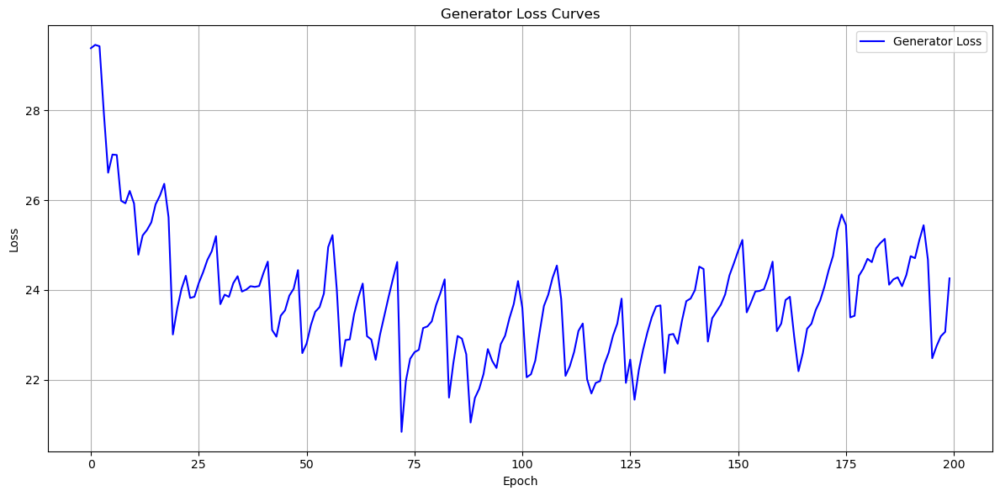

In [15]:
gen_losses = loss_array[:, 0]
adv_losses = loss_array[:, 1]
l1_losses = loss_array[:, 2]
percp_losses = loss_array[:,3]
disc_losses = loss_array[:, 4]

# Plot
plt.figure(figsize=(12, 6))
plt.plot(gen_losses, label='Generator Loss', color='blue')
# plt.plot(adv_losses, label='Adversarial Loss', color='green')
# plt.plot(l1_losses, label='L1 Loss', color='orange')
# plt.plot(disc_losses, label='Discriminator Loss', color='red')

plt.title('Generator Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

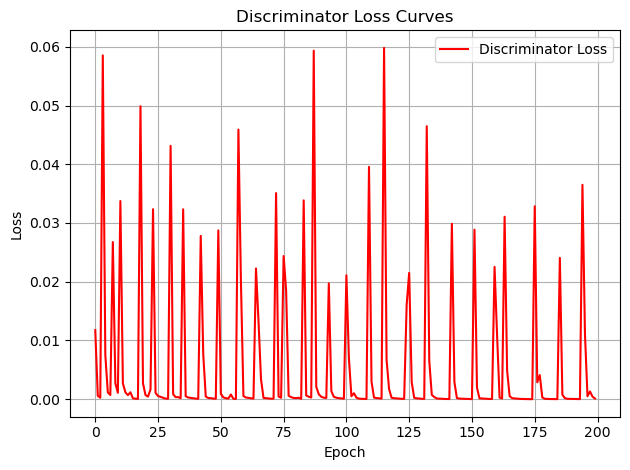

In [13]:
plt.plot(disc_losses, label='Discriminator Loss', color='red')

plt.title('Discriminator Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

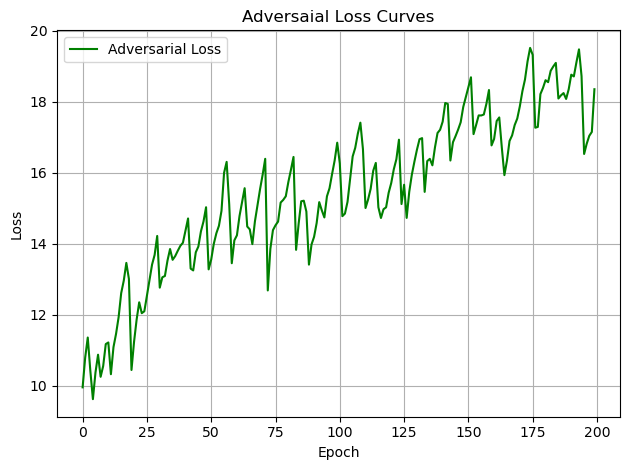

In [17]:
plt.plot(adv_losses, label='Adversarial Loss', color='green')
# plt.plot(l1_losses, label='L1 Loss', color='orange')
# plt.plot(disc_losses, label='Discriminator Loss', color='red')

plt.title('Adversaial Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

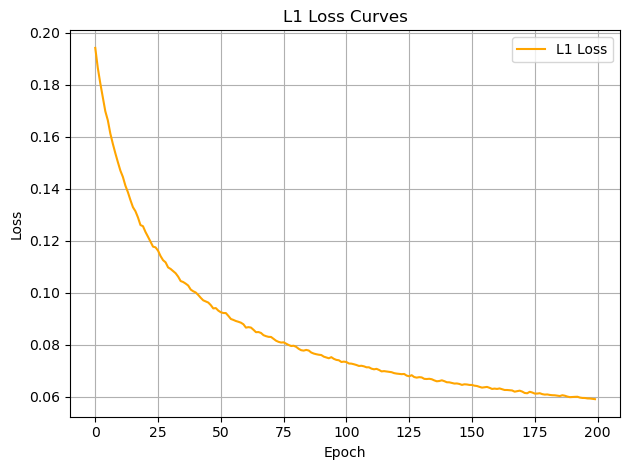

In [19]:
plt.plot(l1_losses, label='L1 Loss', color='orange')
# plt.plot(disc_losses, label='Discriminator Loss', color='red')

plt.title('L1 Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

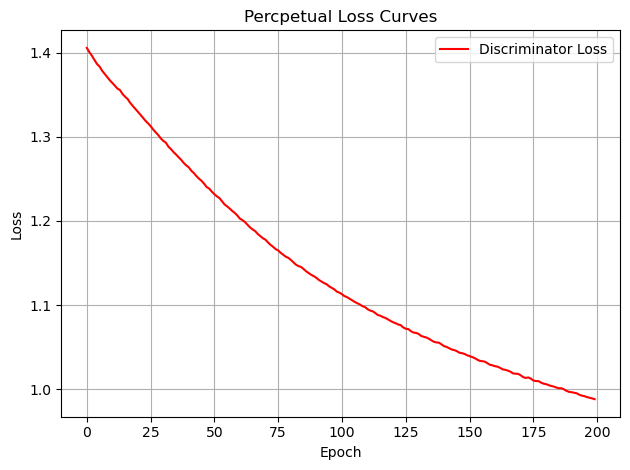

In [21]:
plt.plot(percp_losses, label='Discriminator Loss', color='red')

plt.title('Percpetual Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()